## Look at the Raw Data

In [1]:
!pip install ruptures
!pip install plotly
!pip install pandas
!pip install --upgrade nbformat

In [2]:
import pyabf
import plotly.express as px
import numpy as np
import pandas as pd
import ruptures
import matplotlib.pyplot as plt
import json

signal = pyabf.ABF("/work/zf267656/peltfolder/dnadata/20210703 wtAeL 4M KCl A4 p2 120mV-9.abf")

signal_data = signal.data[0]

## Plotly

In [3]:
signal_data_sliced = signal_data[1:200000]

fig = px.line(signal_data_sliced, labels={'signal'})

fig = px.scatter(signal_data_sliced, labels={'signal'})
fig.show()



## Matplotlib

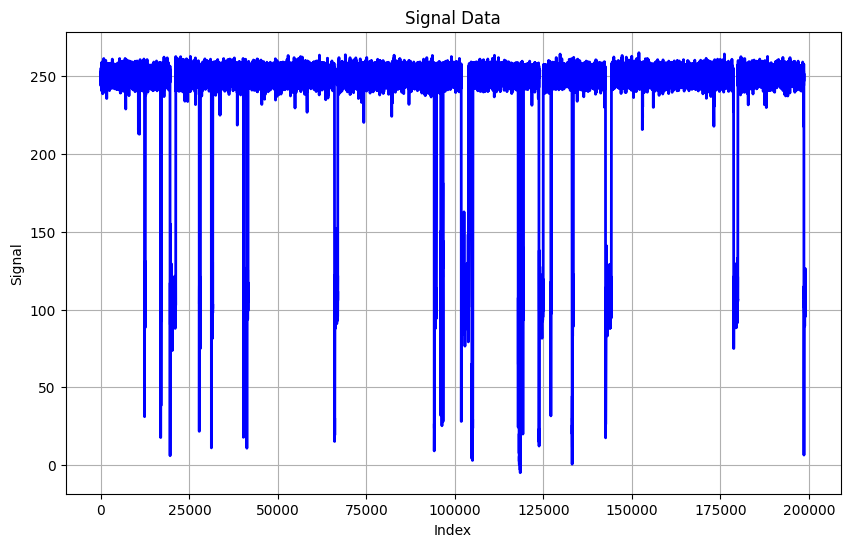

In [4]:
signal_data_sliced = signal_data[1000:200000]
import matplotlib.pyplot as plt

# Assuming 'signal_data' is a Pandas DataFrame and 'signal' is a column in the DataFrame

plt.figure(figsize=(10, 6))
plt.plot(signal_data_sliced, color='#0000ff', linewidth=2)
plt.xlabel('Index')
plt.ylabel('Signal')
plt.title('Signal Data')
plt.grid(True)
plt.show()

## Information about experiment

In [5]:
print(signal.headerText)




ABF Class Methods
abf.getAllXs()
abf.getAllYs()
abf.launchInClampFit()
abf.saveABF1()
abf.setSweep()
abf.sweepD()

ABF Class Variables
abfDateTime = 2024-06-21 12:23:00
abfDateTimeString = 2024-06-21T12:23:00.000000
abfFileComment =                                                         
abfFilePath = /work/zf267656/peltfolder/dnadata/20210703 wtAeL 4M KCl A4 p2 120mV-9.abf
abfFolderPath = /work/zf267656/peltfolder/dnadata
abfID = 20210703 wtAeL 4M KCl A4 p2 120mV-9
abfVersion = {'major': 1, 'minor': 7, 'bugfix': 9, 'build': 9}
abfVersionString = 1.7.9.9
adcNames = ['Imemb']
adcUnits = ['pA']
channelCount = 1
channelList = [0]
creator = AXENGN 2.0.2.6 0.0.0.0
creatorVersion = {'major': 0, 'minor': 0, 'bugfix': 0, 'build': 0}
creatorVersionString = 0.0.0.0
dacNames = ['Cmd 0', 'Cmd 1', 'AO #2', 'AO #3']
dacUnits = ['mV', 'V', 'mV', 'mV']
data = [[256.6986 256.3934 256.1798 ... 250.9918 251.8616 252.2888]]
dataByteStart = 8192
dataLengthMin = 0.36666666666666664
dataLengthSec = 22.0
da

## Denoising

In [6]:
import numpy as np
from scipy import signal
import matplotlib.pyplot as plt  # Optional for visualization


cutoff_frequency = 6  # Adjust this to your desired cutoff frequency
nyquist_freq = 0.5 * 5000 # Nyquist frequency for a 1 Hz sample rate
order = 4  # Filter order (adjust as needed)

b, a = signal.butter(order, cutoff_frequency / nyquist_freq, 'low')


filtered_signal = signal.lfilter(b, a, signal_data)

In [4]:
filtered_data_sliced = filtered_signal[1:200000]

fig = px.line(filtered_data_sliced, labels={'signal'})

fig = px.scatter(signal_data_sliced, labels={'signal'})
fig.show()



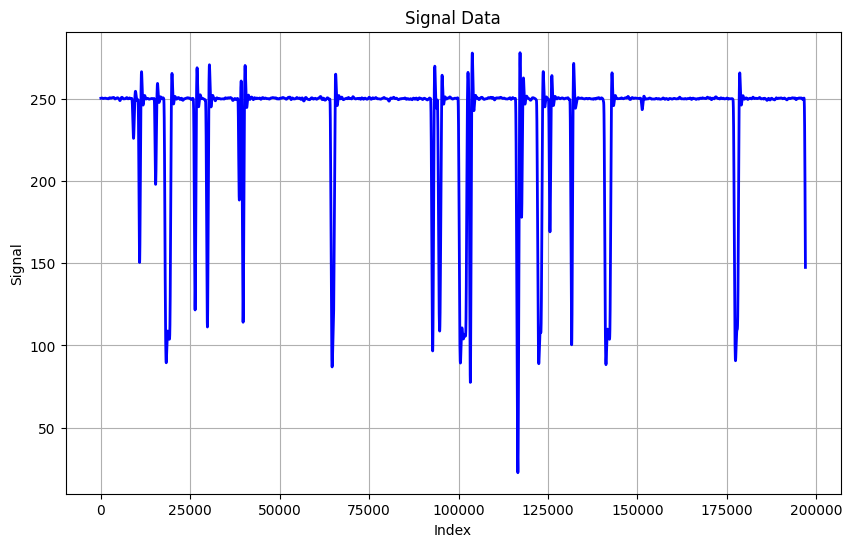

In [7]:
filtered_data_sliced = filtered_signal[3000:200000]

import matplotlib.pyplot as plt

# Assuming 'signal_data' is a Pandas DataFrame and 'signal' is a column in the DataFrame

plt.figure(figsize=(10, 6))
plt.plot(filtered_data_sliced, color='#0000ff', linewidth=2)
plt.xlabel('Index')
plt.ylabel('Signal')
plt.title('Signal Data')
plt.grid(True)
plt.show()

## Event Detection Code Starts

In [8]:
from scipy.io import loadmat
import numpy as np
import scipy
from detection import get_events
import os

import pyabf


samplerate = 40_000_000               #samplerate of signal


rough_detec_params = {
    "s": 4,                         #threshhold of detecting start of event
    "e": 0,                         #threshhold of detection end of event (after start was detected)
    # "dt_exact": 50,               #number of points used to calculate local std/mean (only use when using rd_algo : exact, but generally not neccessary)
    # "rd_algo": "exact",           #if left out, use a recursive lowpass filter for thresh hold, in general leave this out
    # "lag": 1,                     #only necessary when rd_algo : exact is used. Leave it at 1 or 2, not that important
    # "max_event_length": 10e-5,    #maximum duration for a signal to be considered an event and not pore clogging for example (in SI units)
}

fit_method = "c_pelt"               #method to perform level fitting. Can be c_pelt, c_dynamic, cusum, pelt, dynamic
                                    #(difference between c_pelt and pelt are, that with c_pelt you can only use "model": "l2", same with c_dynamic)
                                    #c_pelt is for detecting unknown amounts of levels. Generally leave it at c_pelt or pelt.

fit_params = {
    # "delta": 0.2,                 #parameter for cusum
    # "hbook": 1,                   #parameter for cusum
    # "sigma": 0.0387,              #parameter for cusum
    # "dt_baseline": 50,            #controlls how much of the baseline is given to perform level fitting (need some amout of baseline to see where event starts)
    "fit_event_thresh": 7,         #minimum length of entire event (in number of samples)
    "fit_level_thresh": 5,          #minimum length of one level (in number of samples)
    "pen":  100,                  #sensitivity parameter for pelt/c_pelt. Either pass float (the lower the more levels are detected) or leave it as
                                    #"BIC" or "AIC" for unsupervised level fitting. In paper more information on this.
    "model": "l2",                  #controls what type of changepoints are detected. In Documentation there is more information on this
    # "nr_ct": 5,                   #number of set changepoints if you use fit_method: dynamic/c_dynamic
}


show = False                        #if set to true, you can see how the algorithm detects the levels


## Without any filter

In [10]:
save_folder = "/work/zf267656/peltfolder/analysis/"                                     #path to the folder where you want to save output
file_name = "result-wofilter-120mv-9"            #name of the output file

get_events(signal_data, samplerate, rough_detec_params=rough_detec_params, fit_method=fit_method,
        fit_params=fit_params, show=show, folder_path=save_folder, filename=file_name)


#get_events(filtered_data_sliced, samplerate, rough_detec_params=rough_detec_params, fit_method=fit_method,
#           fit_params=fit_params, show=show, folder_path=save_folder, filename=file_name)


########### information for onput file ############
"""
output file is given as a json file. Written inside are the parameters you set to let the algorithm run. The results are 
saved in a list called "events". Each element of the list represents one event. Inside one element there is:
"signal_w_baseline": the entire signal that was used for the level fitting (includes samples from the baseline)
"start_end_in_sig": the datapoints, where the actual event starts end ends in "signal_w_baseline"
"local_baseline": the local baseline before the event started.
"level_info": information about the levels. This is a list, where one element represents one found level inside the given event.
              One element consists of two values:
              The first value is the drop relative to the baseline, e.g -0.5 would mean that the level is 0.5 below the baseline 
              Second value is how long the event lasted in number of samples
"mean": average current drop, also relative to baseline
"start_end_in_raw": the datapoints, where the event starts in the raw signal (not just the provided signal that is to be fitted)
"std": standard deviation inside the event
"change_times": change times detected by algorithm. The segment between two changet times is one level. First changetime is where event starts and
                last change time is where event ends in the provided "signal_w_baseline"
"height": the height value
"dwell": the dwell time of the event

If you want to get some other features out of the event, you need to adjust the "Event" class inside the "detection.py" file
"""



nr events (rough detec):  2644


'\noutput file is given as a json file. Written inside are the parameters you set to let the algorithm run. The results are \nsaved in a list called "events". Each element of the list represents one event. Inside one element there is:\n"signal_w_baseline": the entire signal that was used for the level fitting (includes samples from the baseline)\n"start_end_in_sig": the datapoints, where the actual event starts end ends in "signal_w_baseline"\n"local_baseline": the local baseline before the event started.\n"level_info": information about the levels. This is a list, where one element represents one found level inside the given event.\n              One element consists of two values:\n              The first value is the drop relative to the baseline, e.g -0.5 would mean that the level is 0.5 below the baseline \n              Second value is how long the event lasted in number of samples\n"mean": average current drop, also relative to baseline\n"start_end_in_raw": the datapoints, where

## With filter

In [ ]:
import collections
import scipy as sc

def filter_sci(x, samplerate, freq, order=3, btype="lowpass"):
    """
    filters a signla in a "bandwidth" maner
    Parameters
    ----------
    x               np.array, signal to be filtered
    freq            int if btype is lowpass or "highpass", "sequence" with 2 elements if btype is "bandpass". Specifies frequency cuttoff or frequence range
    samplerate      int, samplerate
    order           int, order of filter-function

    Returns
    -------
    """
    nyquist = 0.5 * samplerate
    if isinstance(freq, collections.abc.Sequence):  # and len(freq) == 2
        lowcut = freq[0]
        highcut = freq[1]
        low = lowcut / nyquist          #das zum normalisieren. Damit funk unabhängig von samplerate. Ist hier nun zwischen 0 - 1
        high = highcut / nyquist
        freq = np.array([low, high])

    freq = freq / nyquist               #zum normalisieren

    # noinspection PyTupleAssignmentBalance
    b, a = sc.signal.butter(order, freq, btype=btype, output="ba")          #butterworth filter
    #b, a = signal.bessel(order, freq, btype=btype, output="ba")            #bessel filter
    filtered = sc.signal.filtfilt(b, a, x.reshape(1, -1))
    return filtered.reshape(-1, 1)



In [ ]:
import json
data = json.load(open('/home/zz342074/my_calculations/analysis/dna/result-wofilter-1MHz_011.json'))

import matplotlib.pyplot as plt

signal = data["events"][6]["signal_w_baseline"]

plt.plot(range(len(signal)), signal)
plt.show()

In [ ]:
freq = 1000000
signal_filter_lowpass = filter_sci(signal_data, samplerate, freq, order=3, btype="lowpass")



In [ ]:
save_folder = "/home/zz342074/my_calculations/UPENN-data-2023-July/10MHz_Raw_POC_trace/Gordon1/hetero_POC/output/"                                     #path to the folder where you want to save output
file_name = "result-test-filter"            #name of the output file
get_events(signal_filter_lowpass, samplerate, rough_detec_params=rough_detec_params, fit_method=fit_method,
           fit_params=fit_params, show=show, folder_path=save_folder, filename=file_name)



7.4417877197265625


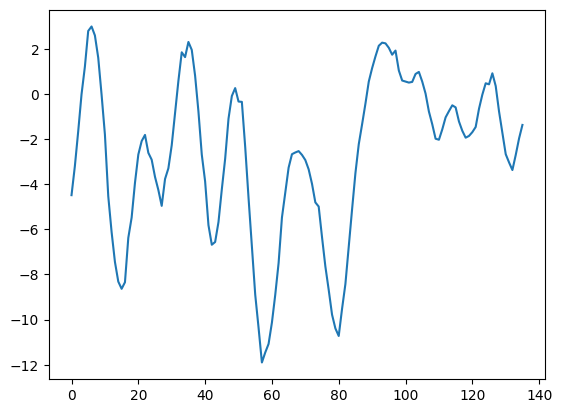

In [19]:
import json
data = json.load(open('/work/zf267656/peltfolder/analysis/result-wofilter-120mv-9.json'))

import matplotlib.pyplot as plt

secondev = data["events"][3]
signal = secondev["signal_w_baseline"]
print(secondev["height"])
plt.plot(range(len(signal)), signal)
plt.show()

In [33]:

events_data = data.get('events', [])
csv_file = 'events_data.csv'

rows = []
counter = 1
for event in events_data:
    level_info_str = ';'.join([f'{lvl[0]}:{lvl[1]}' for lvl in event.get('level_info', [])])
    signal_with_baseline_str = ';'.join(map(str, event.get('signal_with_baseline', [])))
    start_end_in_raw_str = ';'.join(map(str, event.get('start_end_in_raw', [])))
    change_times_str = ';'.join(map(str, event.get('change_times', [])))
    print(level_info_str)
    row = {
        'event_index': counter,
        #'signal_with_baseline_str':signal_with_baseline_str,
        'start_in_sig': event.get('start_end_in_sig', ())[0],  
        'end_in_sig': event.get('start_end_in_sig', ())[1],    
        'local_baseline': round(event.get('local_baseline', None), 3), 
        'level_info_str':level_info_str,
        'mean': round(event.get('mean', None), 3), 
        'start_end_in_raw_str': start_end_in_raw_str,                     
        'std': round(event.get('std', None), 3),
        'change_times_str': change_times_str,                        
        'height': round(event.get('height', None), 3),                  
        'dwell': round(event.get('dwell', None), 3)                            
    }
    counter +=1
    rows.append(row)

df = pd.DataFrame(rows)
df.to_csv(csv_file, index=False)

print(f"CSV file '{csv_file}' created successfully.")

-7.183685302734375:14;-0.0108489990234375:9
-4.726043701171875:42;-11.467391967773438:9;-1.8003387451171875:21
-5.073760986328125:9
-6.90509033203125:8;-2.2206878662109375:35;-9.6624755859375:9;-3.6365203857421875:12;-8.33599853515625:10
-15.974807739257812:23;2.0569915771484375:28
-8.456222534179688:9;2.3965301513671875:19;-33.163604736328125:18;-29.65948486328125:37;-35.01338195800781:17;-26.01763916015625:7;-33.807861328125:27;-29.057891845703125:11;-35.33966064453125:8;-29.527572631835938:40;-23.702926635742188:8;-31.682083129882812:64;-26.906143188476562:15;-34.65846252441406:14;-24.90057373046875:11;-34.1126708984375:34;-4.783935546875:8;1.3186187744140625:16;-5.9954986572265625:10
-215.4499053955078:23;-141.67974853515625:11;-150.1860809326172:23;-142.59251403808594:10;-149.283935546875:17;-139.25677490234375:18;-153.32247924804688:10;-144.30148315429688:13;-137.685546875:12;-144.6862335205078:14;-122.59281921386719:10;-130.8712158203125:6;-144.28878784179688:6;-158.302947998046

In [22]:
import pandas as pd

data2 = json.load(open('/home/zz342074/my_calculations/machine_learning/UPENN/output/result-test-wofilter.json'))

#data2.to_json('/home/zz342074/my_calculations/machine_learning/UPENN/output/result-test.json')

len(event_info).data2

PermissionError: [Errno 13] Permission denied: '/home/zz342074/my_calculations/machine_learning/UPENN/output/result-test-wofilter.json'

In [ ]:
events = [[]]

for i in 787:
    signal = data["events"][i]["signal_w_baseline"]
    events.append(signal)

